In [1]:
import pickle
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.utils.data as Data
import torch.nn.functional as F
from torch_geometric.nn import GATConv, SAGPooling,global_mean_pool , global_max_pool 
from sklearn.metrics import mean_absolute_error
from torch import optim

In [2]:
plt.rcParams['font.sans-serif']=['Microsoft YaHei']

## fingat源码的关于编码的代码

In [3]:
class AttentionBlock(nn.Module):
    def __init__(self,time_step,dim):
        super(AttentionBlock, self).__init__()
        self.attention_matrix = nn.Linear(time_step, time_step)

    def forward(self, inputs):
        inputs_t = torch.transpose(inputs,2,1) # (batch_size, input_dim, time_step)
        attention_weight = self.attention_matrix(inputs_t)
        attention_probs = F.softmax(attention_weight,dim=-1)
        attention_probs = torch.transpose(attention_probs,2,1)
        attention_vec = torch.mul(attention_probs, inputs)
        attention_vec = torch.sum(attention_vec,dim=1)
        return attention_vec, attention_probs

class SequenceEncoder(nn.Module):
    def __init__(self,input_dim,time_step,hidden_dim):
        super(SequenceEncoder, self).__init__()
        self.encoder = nn.GRU(input_size=input_dim,hidden_size=hidden_dim,num_layers=1,batch_first=True)
        self.attention_block = AttentionBlock(time_step,hidden_dim) 
        self.dropout = nn.Dropout(0.2)
        self.dim = hidden_dim
    
    def forward(self,seq):
        '''
        inp : torch.tensor (batch,time_step,input_dim)
        '''
        seq_vector,_ = self.encoder(seq)
        seq_vector = self.dropout(seq_vector)
        attention_vec, attention_probs = self.attention_block(seq_vector)
        attention_vec = attention_vec.view(-1,1,self.dim) # prepare for concat
        return attention_vec, attention_probs

## 导入数据

In [4]:
with open('./datasets/sp500_data.pkl', "rb") as f:
    data = pickle.load(f)

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [6]:
train_x = data['train']['x1']
train_x.shape

(1580, 480, 7, 30)

In [7]:
train_y = data['train']['y_return ratio']
train_y.shape

(1580, 480)

In [19]:
data['test']['x1'].shape

(390, 480, 7, 30)

## 先选取一支股票查看attention

In [8]:
attention_x = data['train']['x1'][:,0,:,1:]
attention_x.shape

(1580, 7, 29)

In [9]:
attention_y = data['train']['y_return ratio'][:,0]
attention_y.shape

(1580,)

In [10]:
attention_y

array([ 0.00710482,  0.00352735,  0.00333917, ..., -0.00472977,
       -0.03665988, -0.00422829])

## 设立pytorch的dataloader

In [11]:
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam

class StockDataset(Dataset):
    def __init__(self, x, y):
        self.x = x
        self.y = y

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        return self.x[idx], self.y[idx]

def create_dataloader(x, y, batch_size):
    dataset = StockDataset(x, y)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    return dataloader

In [12]:
dataloader = create_dataloader(attention_x, attention_y, batch_size=16)

In [13]:
for batch_idx, (seq, target) in enumerate(dataloader):
    print(batch_idx)
    print(seq.shape)
    print(target.view(-1,1).shape)
    print("=========================")

0
torch.Size([16, 7, 29])
torch.Size([16, 1])
1
torch.Size([16, 7, 29])
torch.Size([16, 1])
2
torch.Size([16, 7, 29])
torch.Size([16, 1])
3
torch.Size([16, 7, 29])
torch.Size([16, 1])
4
torch.Size([16, 7, 29])
torch.Size([16, 1])
5
torch.Size([16, 7, 29])
torch.Size([16, 1])
6
torch.Size([16, 7, 29])
torch.Size([16, 1])
7
torch.Size([16, 7, 29])
torch.Size([16, 1])
8
torch.Size([16, 7, 29])
torch.Size([16, 1])
9
torch.Size([16, 7, 29])
torch.Size([16, 1])
10
torch.Size([16, 7, 29])
torch.Size([16, 1])
11
torch.Size([16, 7, 29])
torch.Size([16, 1])
12
torch.Size([16, 7, 29])
torch.Size([16, 1])
13
torch.Size([16, 7, 29])
torch.Size([16, 1])
14
torch.Size([16, 7, 29])
torch.Size([16, 1])
15
torch.Size([16, 7, 29])
torch.Size([16, 1])
16
torch.Size([16, 7, 29])
torch.Size([16, 1])
17
torch.Size([16, 7, 29])
torch.Size([16, 1])
18
torch.Size([16, 7, 29])
torch.Size([16, 1])
19
torch.Size([16, 7, 29])
torch.Size([16, 1])
20
torch.Size([16, 7, 29])
torch.Size([16, 1])
21
torch.Size([16, 7, 2

## 建立模型，设置优化器、损失，进行训练

In [14]:
# 建立
sequence_encoder = SequenceEncoder(input_dim=29, time_step=7, hidden_dim=64)

# 定义损失和优化
criterion = nn.MSELoss()  # 因为是回归问题，所以我们使用均方误差损失
optimizer = Adam(sequence_encoder.parameters(), lr=0.001)

In [15]:
# 5. 训练模型
def train_model(model, dataloader, epochs):
    model = model.to(device)
    model.train()
    for epoch in range(epochs):
        for batch_idx, (seq, target) in enumerate(dataloader):
            seq = seq.to(device).float()
            target = target.to(device).float()
            optimizer.zero_grad()
            seq = seq.view(-1, 7, 29)  # Reshape to (batch_size * num_stocks, time_step, input_dim)
#             print(seq.shape)  #  [5984, 7, 30]
            target = target.view(-1,1)  # Flatten target to have shape (batch_size * num_stocks)
#             print(target.shape)  #  [5984, 1]
            attention_vec,attention_probs = model(seq)
            attention_vec = attention_vec.squeeze()  # Remove extra dimensions to match target shape
            loss = criterion(attention_vec, target)
            loss.backward()
            optimizer.step()
            if batch_idx % 15 == 0:
                print(f'Epoch {epoch}, Batch {batch_idx}, Loss {loss.item()}')

# 开始训练
train_model(sequence_encoder, dataloader, epochs=50)

D:\_Application\anaconda3\envs\Pytorch\lib\site-packages\torch\nn\modules\loss.py:535: UserWarning: Using a target size (torch.Size([16, 1])) that is different to the input size (torch.Size([16, 64])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 0, Batch 0, Loss 0.010589280165731907
Epoch 0, Batch 15, Loss 0.0051041292026638985
Epoch 0, Batch 30, Loss 0.004046319518238306
Epoch 0, Batch 45, Loss 0.0025109057314693928
Epoch 0, Batch 60, Loss 0.002271991688758135
Epoch 0, Batch 75, Loss 0.0011862344108521938
Epoch 0, Batch 90, Loss 0.0010524861281737685
Epoch 1, Batch 0, Loss 0.0008794362656772137
Epoch 1, Batch 15, Loss 0.0002453866763971746
Epoch 1, Batch 30, Loss 0.0003049308725167066


D:\_Application\anaconda3\envs\Pytorch\lib\site-packages\torch\nn\modules\loss.py:535: UserWarning: Using a target size (torch.Size([12, 1])) that is different to the input size (torch.Size([12, 64])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 1, Batch 45, Loss 0.00038238760316744447
Epoch 1, Batch 60, Loss 0.0003381962887942791
Epoch 1, Batch 75, Loss 0.0010888816323131323
Epoch 1, Batch 90, Loss 0.0002689155226107687
Epoch 2, Batch 0, Loss 0.00044206317397765815
Epoch 2, Batch 15, Loss 0.0005515480879694223
Epoch 2, Batch 30, Loss 0.0007228656322695315
Epoch 2, Batch 45, Loss 0.0004532605817075819
Epoch 2, Batch 60, Loss 0.00030792446341365576
Epoch 2, Batch 75, Loss 0.0006566293304786086
Epoch 2, Batch 90, Loss 0.00032408908009529114
Epoch 3, Batch 0, Loss 0.0016839394811540842
Epoch 3, Batch 15, Loss 0.0009277978097088635
Epoch 3, Batch 30, Loss 0.0006776769878342748
Epoch 3, Batch 45, Loss 0.0009330345783382654
Epoch 3, Batch 60, Loss 0.0003684570256154984
Epoch 3, Batch 75, Loss 0.000877333921380341
Epoch 3, Batch 90, Loss 0.0004997841897420585
Epoch 4, Batch 0, Loss 0.0001423255744157359
Epoch 4, Batch 15, Loss 0.0005699988105334342
Epoch 4, Batch 30, Loss 0.0005582945886999369
Epoch 4, Batch 45, Loss 0.00042856

Epoch 26, Batch 75, Loss 0.0009749164455570281
Epoch 26, Batch 90, Loss 0.00037498935125768185
Epoch 27, Batch 0, Loss 0.0006720640230923891
Epoch 27, Batch 15, Loss 0.0008763042860664427
Epoch 27, Batch 30, Loss 0.00035074411425739527
Epoch 27, Batch 45, Loss 0.000258567655691877
Epoch 27, Batch 60, Loss 0.0006980448961257935
Epoch 27, Batch 75, Loss 0.0003943877527490258
Epoch 27, Batch 90, Loss 0.0005061153206042945
Epoch 28, Batch 0, Loss 0.00033821776742115617
Epoch 28, Batch 15, Loss 0.0004768802027683705
Epoch 28, Batch 30, Loss 0.00014147581532597542
Epoch 28, Batch 45, Loss 0.00046117909369058907
Epoch 28, Batch 60, Loss 0.0003084720519836992
Epoch 28, Batch 75, Loss 0.0007112424355000257
Epoch 28, Batch 90, Loss 0.00029564613942056894
Epoch 29, Batch 0, Loss 0.0005887337028980255
Epoch 29, Batch 15, Loss 0.0017603615997359157
Epoch 29, Batch 30, Loss 0.0009222009684890509
Epoch 29, Batch 45, Loss 0.0002656770229805261
Epoch 29, Batch 60, Loss 0.0012342446716502309
Epoch 29, B

In [20]:
# 评估模型
sequence_encoder.eval()

# 不需要计算梯度
with torch.no_grad():
    input = torch.Tensor(attention_x).view(-1, 7, 29).to(device)
    print(input.size())
    attention_vecs, attention_probs = sequence_encoder(input)

torch.Size([1580, 7, 29])


In [21]:
attention_vecs.size()

torch.Size([1580, 1, 64])

In [22]:
attention_probs.size()

torch.Size([1580, 7, 64])

In [23]:
# 变换形状
probs = torch.mean(attention_probs, dim=2, keepdim=True).squeeze(2)
probs.size()

torch.Size([1580, 7])

In [24]:
attention_score = probs.cpu().numpy()
close = train_x[:,0,:,0]

In [48]:
close.shape

(1580, 7)

In [26]:
attention_score[0]

array([0.12784827, 0.21041058, 0.11848955, 0.1542668 , 0.1219774 ,
       0.11094406, 0.15606333], dtype=float32)

In [27]:
np.argsort(attention_score[0])[-3:]

array([3, 6, 1], dtype=int64)

In [29]:
close.shape

(1580, 7)

In [53]:
df = pd.read_csv('./SP500_dataset/LVS.csv', encoding='ISO-8859-1')
time = df['Date'][30:].to_numpy()
time

array(['2015-02-17', '2015-02-18', '2015-02-19', ..., '2022-12-28',
       '2022-12-29', '2022-12-30'], dtype=object)

In [42]:
y = []
z = []
top_indices = []
for i in range(close.shape[0]):
    if (i+1)%7 == 1:
        y.append(close[i])
        z.append(attention_score[i])

In [47]:
close_label = np.hstack(y)
close_label.shape

(1582,)

In [51]:
attention_scores = np.hstack(z)
attention_scores.shape

(1582,)

In [57]:
attention_pic = {}
attention_pic['score'] = z
attention_pic['time'] = time
attention_pic['price'] = close_label

In [59]:
with open("./datasets/attention_pic.pkl" , 'wb') as file:
    pickle.dump(attention_pic, file)

## 可视化

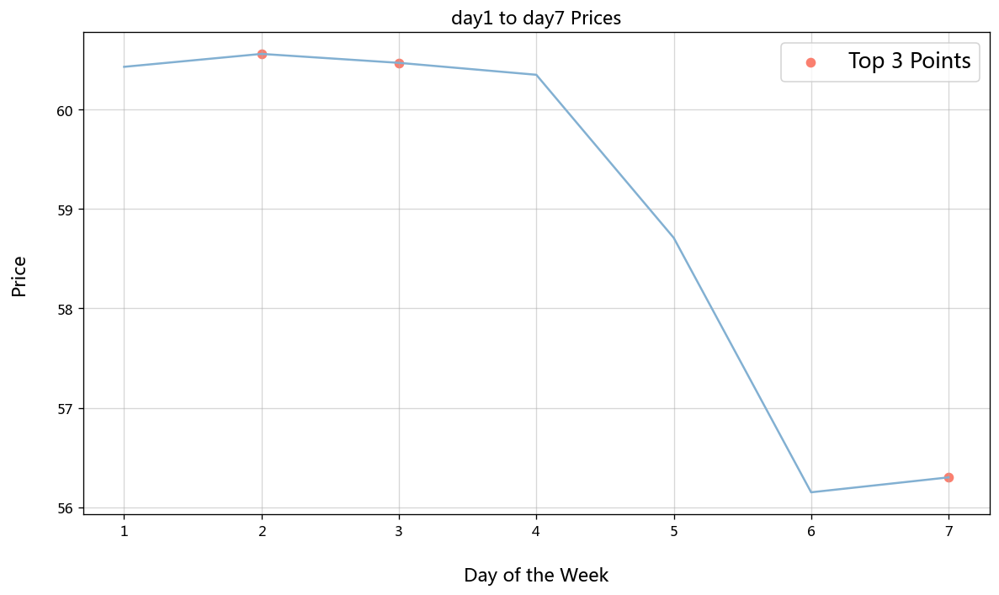

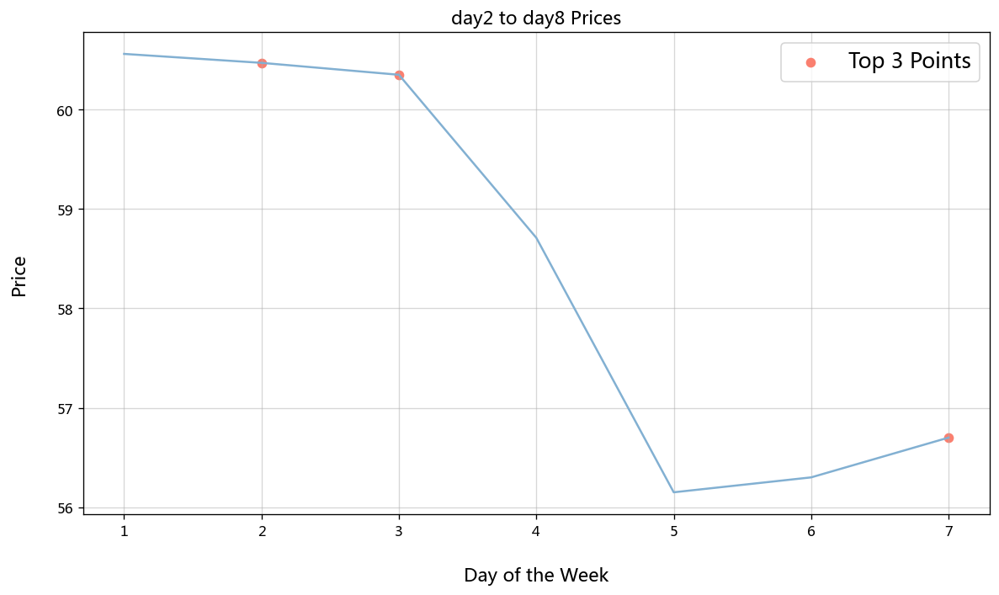

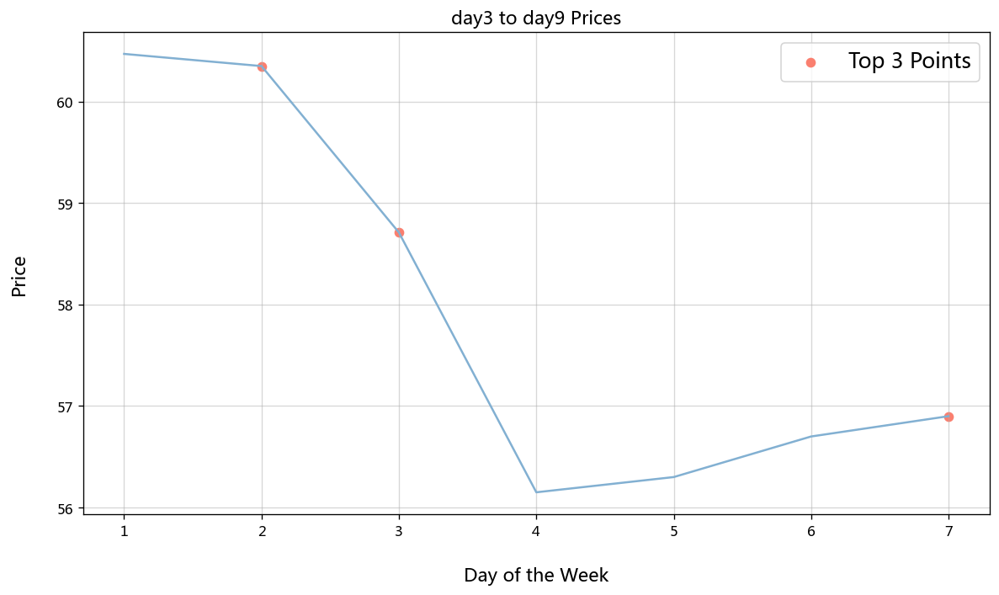

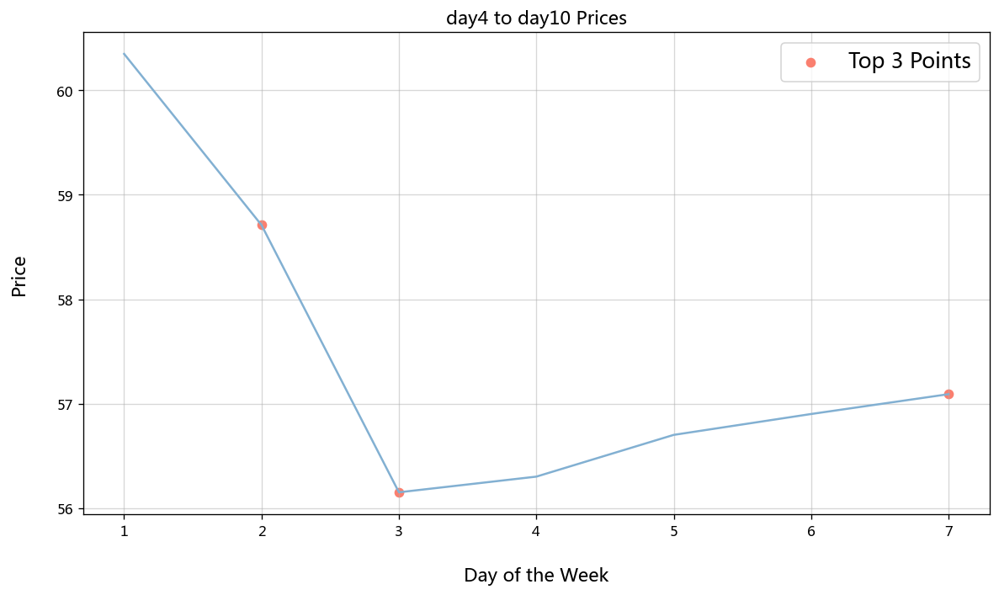

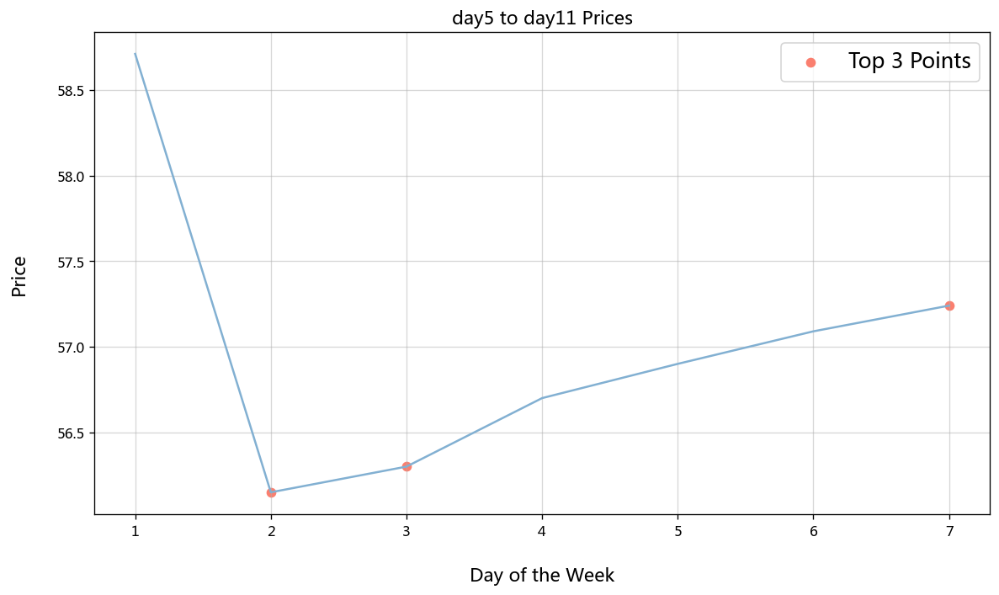

...

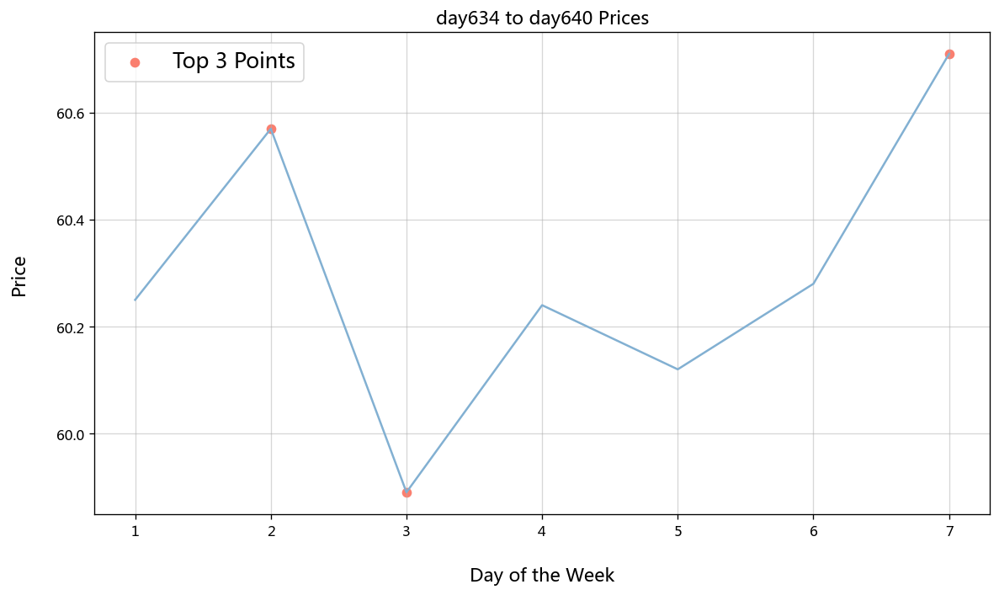

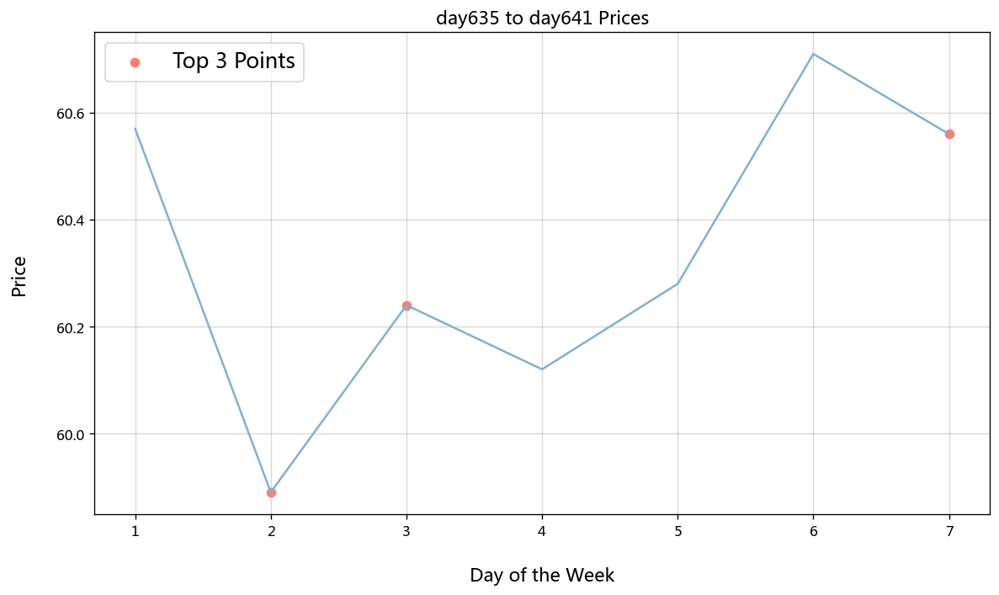

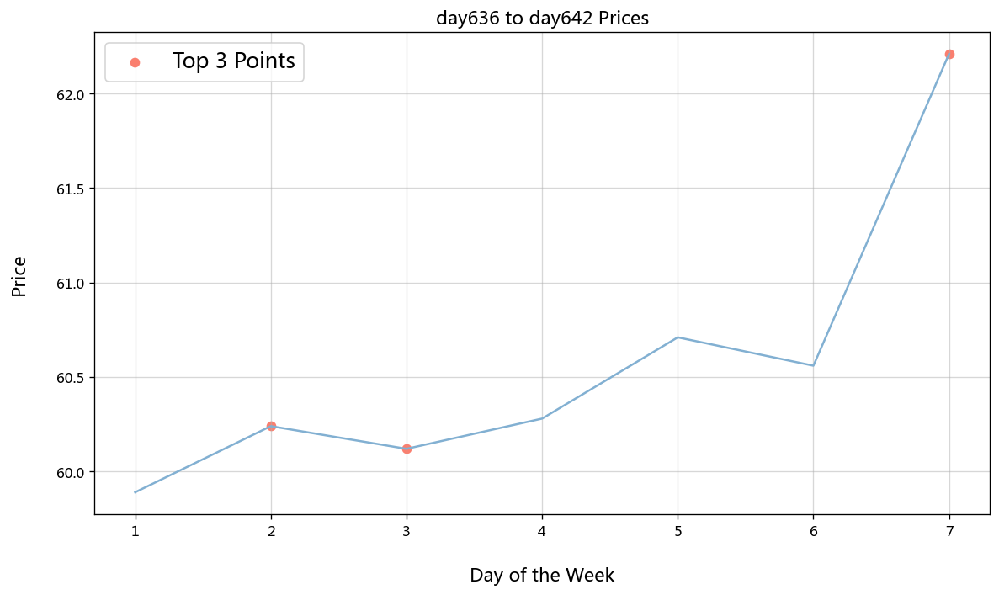

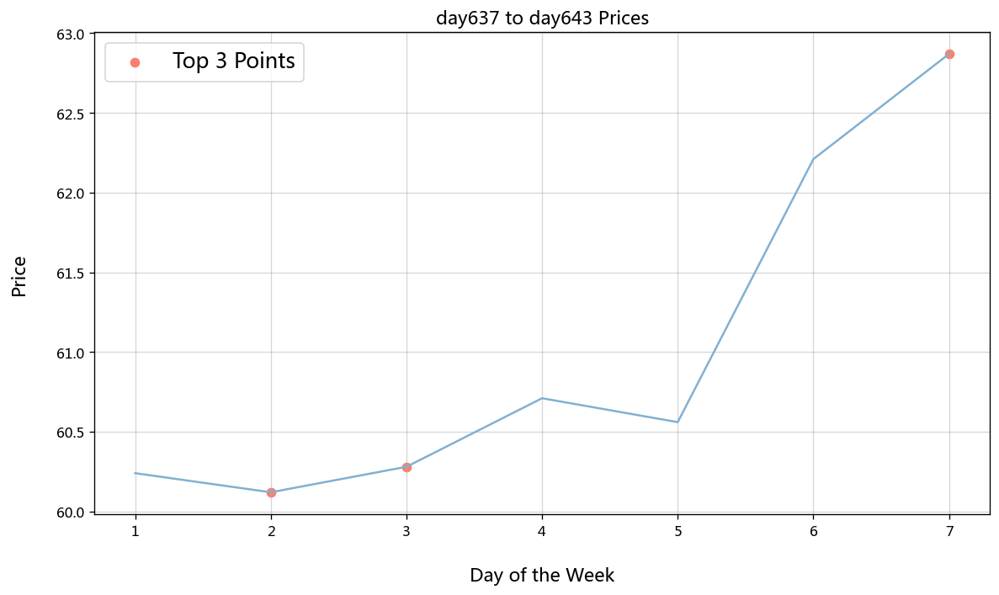

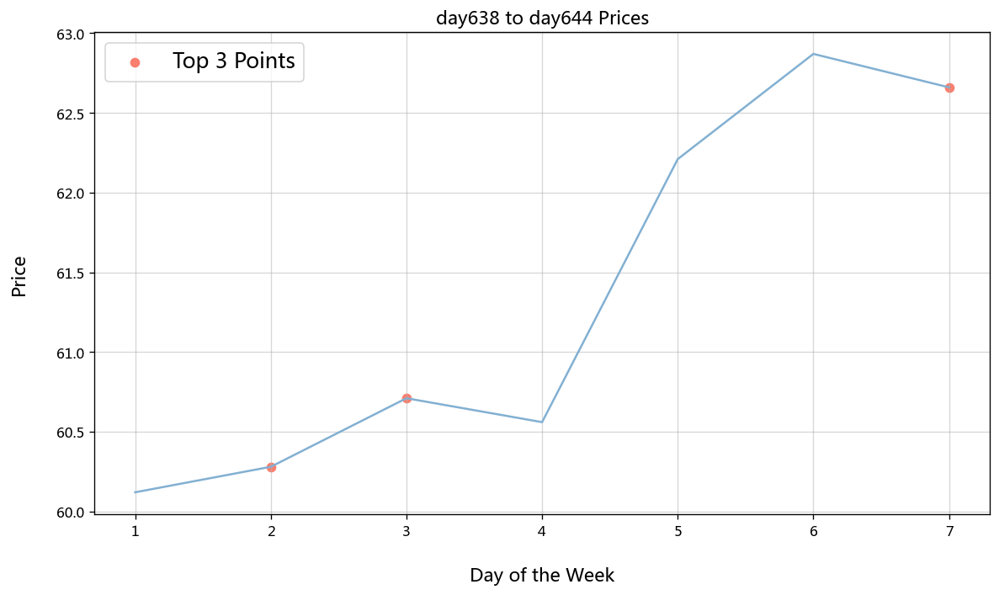

KeyboardInterrupt: 

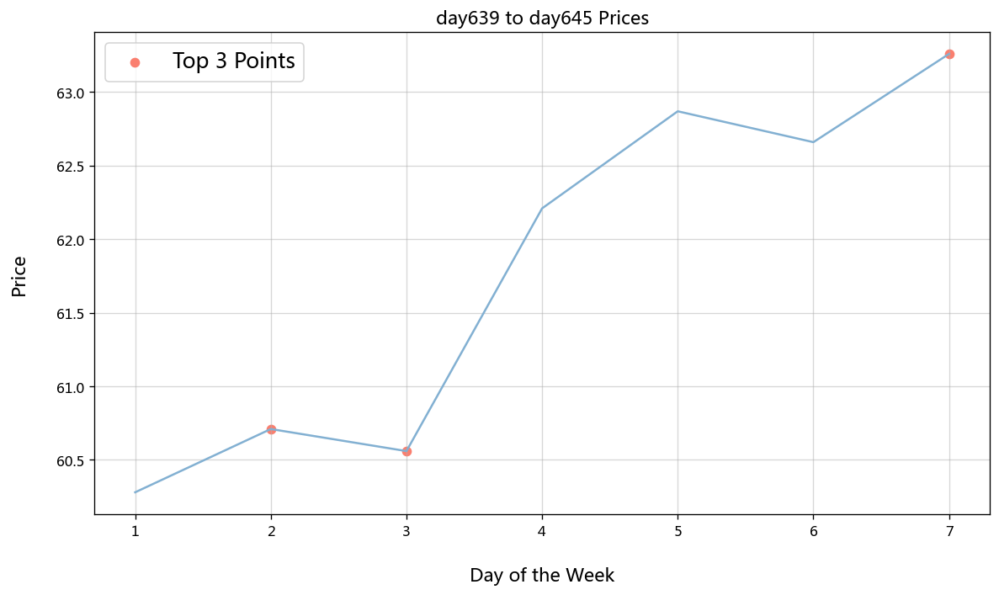

In [125]:
for i in range(close.shape[0]):
    x = np.array([1, 2 , 3 , 4 , 5, 6, 7])
    y = close[i]
    top_indices = np.argsort(attention_score[i])[-3:]
    plt.figure(figsize=(10, 6),dpi=120)
    plt.plot(x, y, color = '#82B0D2')
    plt.scatter(x[top_indices], y[top_indices], color='#FA7F6F', label='Top 3 Points')
    plt.title(f"day{i+1} to day{i+7} Prices",fontsize=13)
    plt.xlabel("Day of the Week",labelpad=20,fontsize=13)
    plt.ylabel("Price",labelpad=20,fontsize=13)
    plt.legend(fontsize=15)
    plt.grid(alpha=.5)
    plt.tight_layout()
    plt.savefig(f'./output/pic/2023-11-28/{i+1}to{i+7}.png',bbox_inches = 'tight',dpi=150)
    plt.show()